In [18]:
import warnings

warnings.filterwarnings('ignore')

# On the morphological composition of cities and how to measure it

## Martin Fleischmann

22 September 2020, GeoPython

## Martin Fleischmann

<div style='float: right'><img src="https://martinfleischmann.net/wordpress/wp-content/uploads/2019/12/2019_blue_circ-300x300.png"></div>

Geographic Data Science Lab, University of Liverpool

[@martinfleis](https://twitter.com/martinfleis)

[martinfleischmann.net](https:martinfleischmann.net)

martin@martinfleischmann.net

<center><img src="figures/gdsl.png"  style="width:50%"><center>

<center><img src="https://github.com/geopandas/geopandas/raw/master/doc/source/_static/logo/geopandas_logo.svg"  style="width:50%"><center>

<center><img src="https://pysal.org/assets/pysal_nav_logo.svg" style="width:40%"></center>

<center><img src="https://raw.githubusercontent.com/martinfleis/momepy/master/docs/_static/logo.svg" style="width:40%"><center>

## What do you mean by morphological composition?

<center><img src="figures/prague_jay_danntine.jpg"><center>

<center><img src="figures/paris_george_kantarzis.jpg"><center>

<center><img src="figures/ny_anuj_gogari.jpg"><center>

<center><img src="figures/tokyo_masaaki_komori.png"><center>

<center><img src="figures/town_stephen_oliver.jpg"><center>

<center><img src="figures/sao_paulo_jonathan_borba.jpg"><center>

<center><img src="figures/sao_paulo.png"><center>

<center><img src="figures/barcelona.png"><center>

<center><img src="figures/brasilia.png"><center>

<center><img src="figures/atlanta.png"><center>

## How do I capture that?

Streets

Buildings

~Plots~

Getting OpenStreetMap data using `osmnx` by Geoff Boeing.

In [2]:
import osmnx as ox

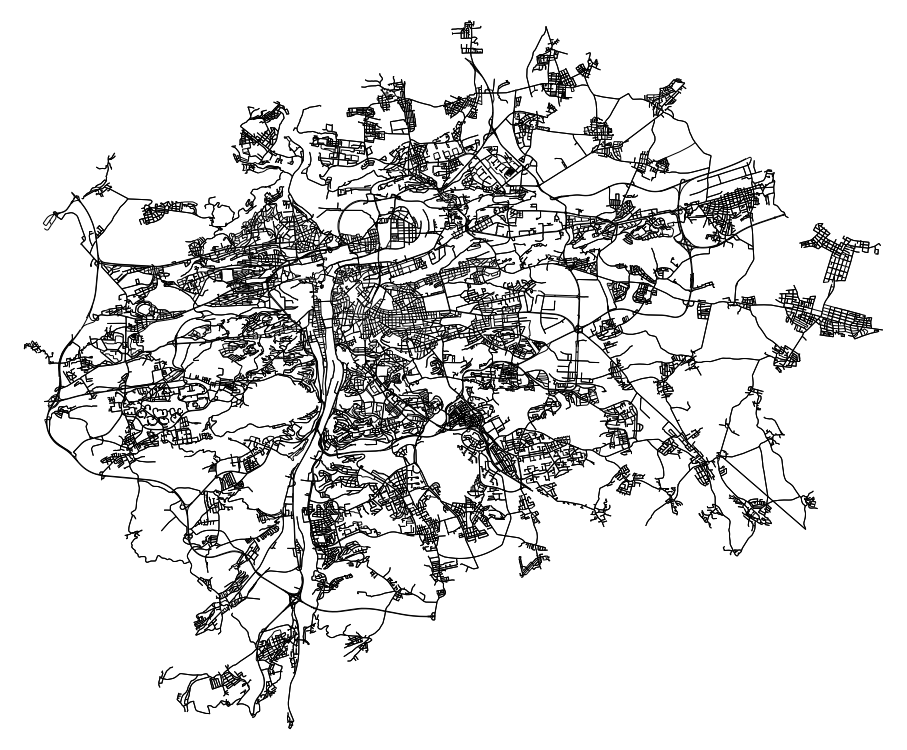

In [33]:
# specify center point and distance
G = ox.graph_from_place('Prague', network_type='drive')
fig, ax = ox.plot_graph(G, node_size=0, bgcolor='white', edge_color='black', figsize=(16, 16))

In [6]:
# save data to GeoPandas GeoDataFrames
nodes, edges = ox.graph_to_gdfs(G)

Getting OpenStreetMap data using `pyrosm` by Henrikki Tenkanen.

In [8]:
import pyrosm

In [28]:
# Dowload data for Prague
data_file = pyrosm.get_data('prag')

Downloaded Protobuf data 'Prag.osm.pbf' (35.93 MB) to:
'/var/folders/kp/fxnnw89x5qbb9gryn507p03c0000gn/T/pyrosm/Prag.osm.pbf'


In [30]:
# Initialize the OSM object
osm = pyrosm.OSM(data_file)

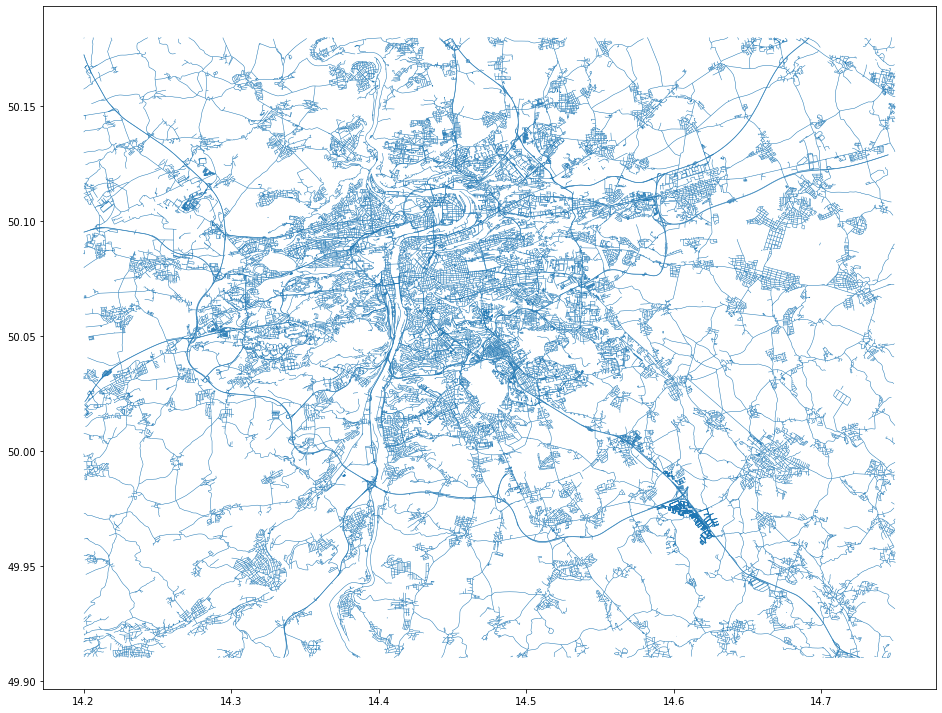

In [31]:
streets = osm.get_network(network_type="driving")
streets.plot(linewidth=0.5, figsize=(16, 16))

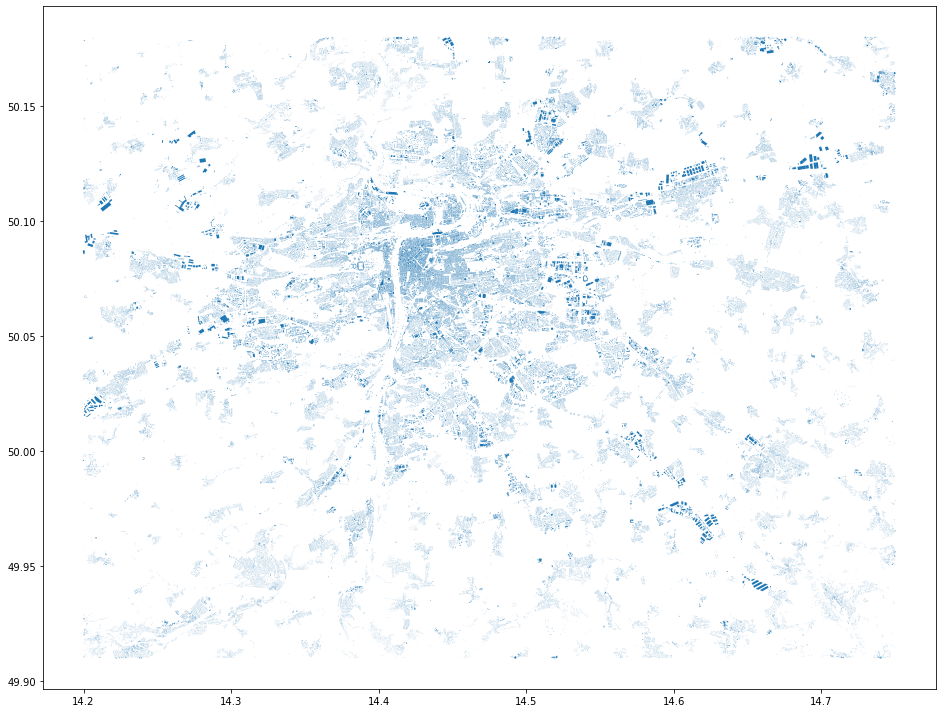

In [32]:
buildings = osm.get_buildings()
buildings.plot(figsize=(16, 16))

In [151]:
sample_buildings = buildings.cx[14.375:14.475, 50.07:50.14].to_crs(epsg=5514)
sample_streets = streets.cx[14.375:14.475, 50.07:50.14].to_crs(epsg=5514)

In [45]:
import matplotlib.pyplot as plt
import contextily

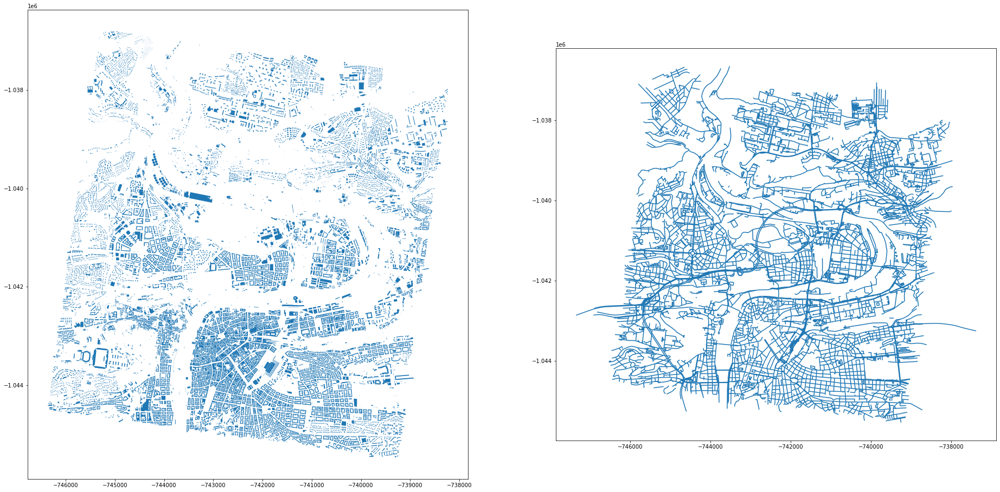

In [49]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot(ax=axs[0])
sample_streets.plot(ax=axs[1])

## Let's measure!

Wait! We should clean the data first.

## Clean the data

In [152]:
sample_buildings = sample_buildings.explode().reset_index(drop=True)

In [153]:
sample_buildings.type.value_counts()

Polygon       30926
LineString        2
dtype: int64

In [135]:
sample_buildings = sample_buildings[sample_buildings.type == 'Polygon']

In [154]:
sample_buildings.is_valid.all()

False

In [141]:
sample_buildings.geometry = sample_buildings.buffer(0)

In [142]:
sample_buildings.is_valid.all()

True

In [ ]:
import momepy

In [143]:
sample_buildings = momepy.preprocess(sample_buildings, compactness=None, loops=1, verbose=False)

## Let's measure!

In [50]:
sample_buildings['area'] = sample_buildings.area
sample_streets['length'] = sample_streets.length

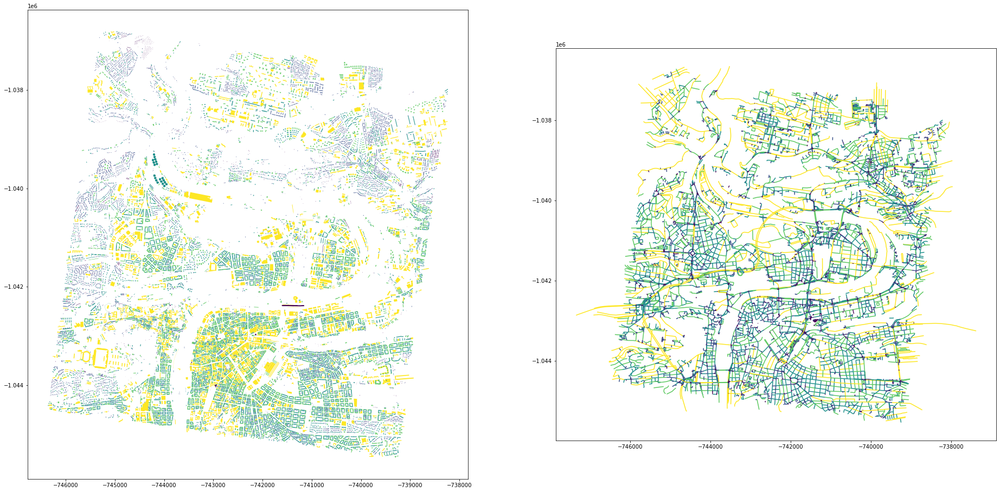

In [57]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot('area', ax=axs[0], scheme='JenksCaspallSampled')
graph = momepy.gdf_to_nx(streets, approach='primal').plot('length', ax=axs[1], scheme='JenksCaspallSampled')

## What about a spatial unit?

### Here comes morphological tessellation

In [60]:
import geopandas as gpd

In [62]:
bubenec_blg = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='buildings')
bubenec_tess = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='tessellation')

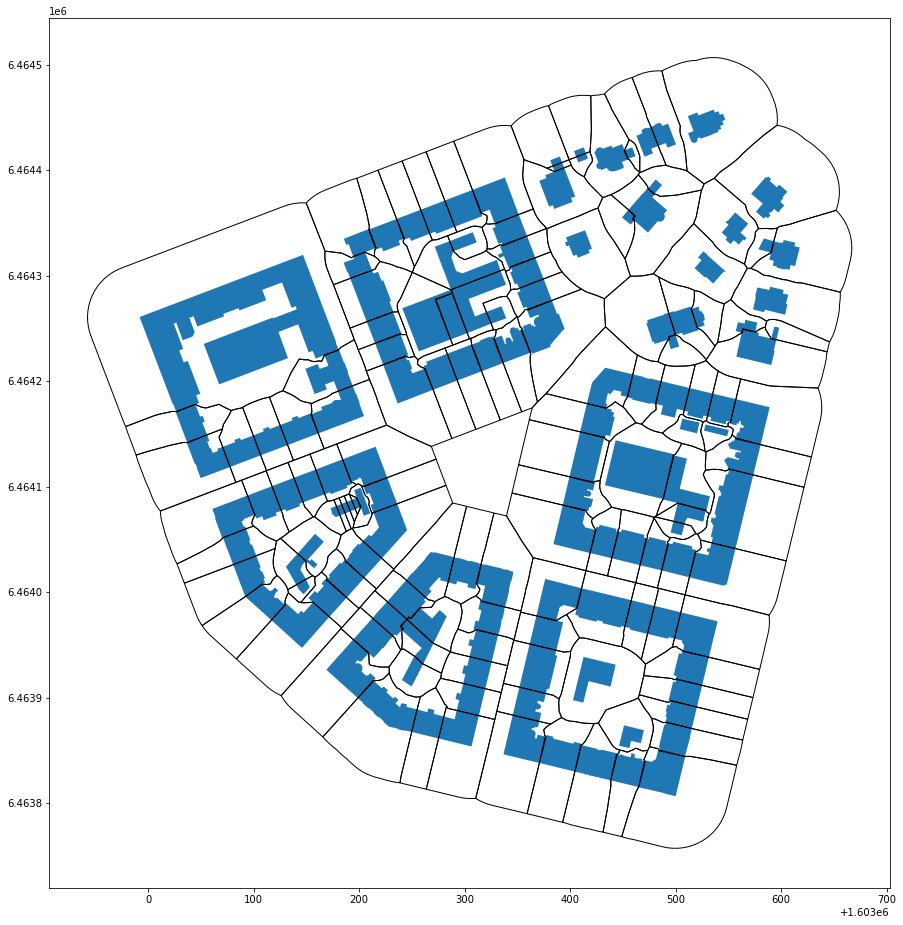

In [64]:
ax = bubenec_blg.plot(figsize=(16, 16))
bubenec_tess.plot(ax=ax, facecolor='none', edgecolor='k')

In [65]:
sample_buildings['uID'] = range(len(sample_buildings))

In [66]:
limit = momepy.buffered_limit(sample_buildings)
tess = momepy.Tessellation(sample_buildings, unique_id='uID', limit=limit, verbose=False)

Inward offset...
Discretization...


  0%|          | 0/30876 [00:00<?, ?it/s]

Generating input point array...


100%|██████████| 30876/30876 [00:20<00:00, 1536.93it/s]


Generating Voronoi diagram...
Generating GeoDataFrame...


Vertices to Polygons: 100%|██████████| 4314632/4314632 [01:18<00:00, 55161.49it/s]


Dissolving Voronoi polygons...
Preparing limit for edge resolving...
Building R-tree...
Identifying edge cells...
Cutting...


100%|██████████| 94/94 [00:00<00:00, 851.77it/s]


In [67]:
sample_tessellation = tess.tessellation

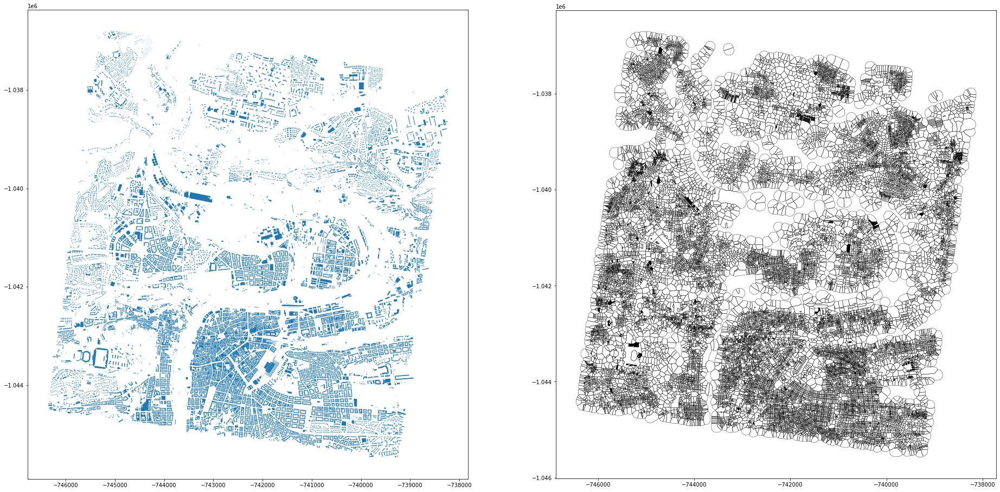

In [68]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot(ax=axs[0])
sample_tessellation.plot(ax=axs[1], facecolor='none', edgecolor='k', linewidth=.4)

In [69]:
sample_tessellation['covered_area_ratio'] = momepy.AreaRatio(sample_tessellation, 
                                                             sample_buildings, 
                                                             left_areas=sample_tessellation.area, 
                                                             right_areas='area', 
                                                             unique_id='uID').series

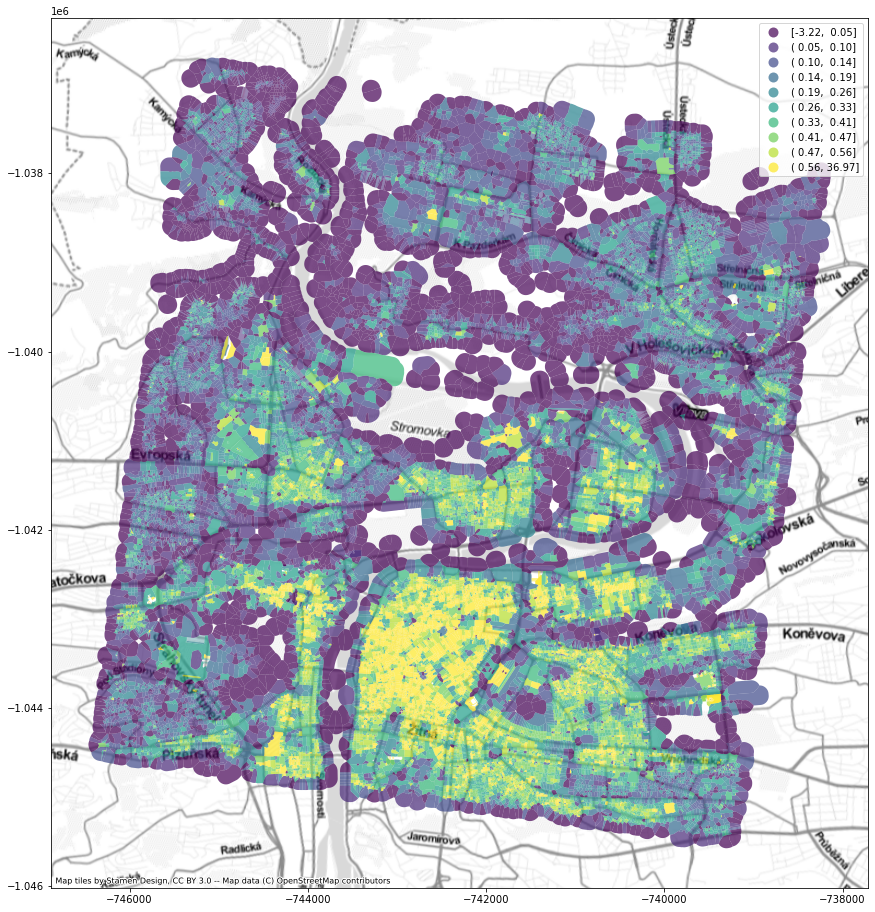

In [124]:
ax = sample_tessellation.plot('covered_area_ratio', figsize=(16, 16), scheme='Quantiles', k=10, legend=True, alpha=.7)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

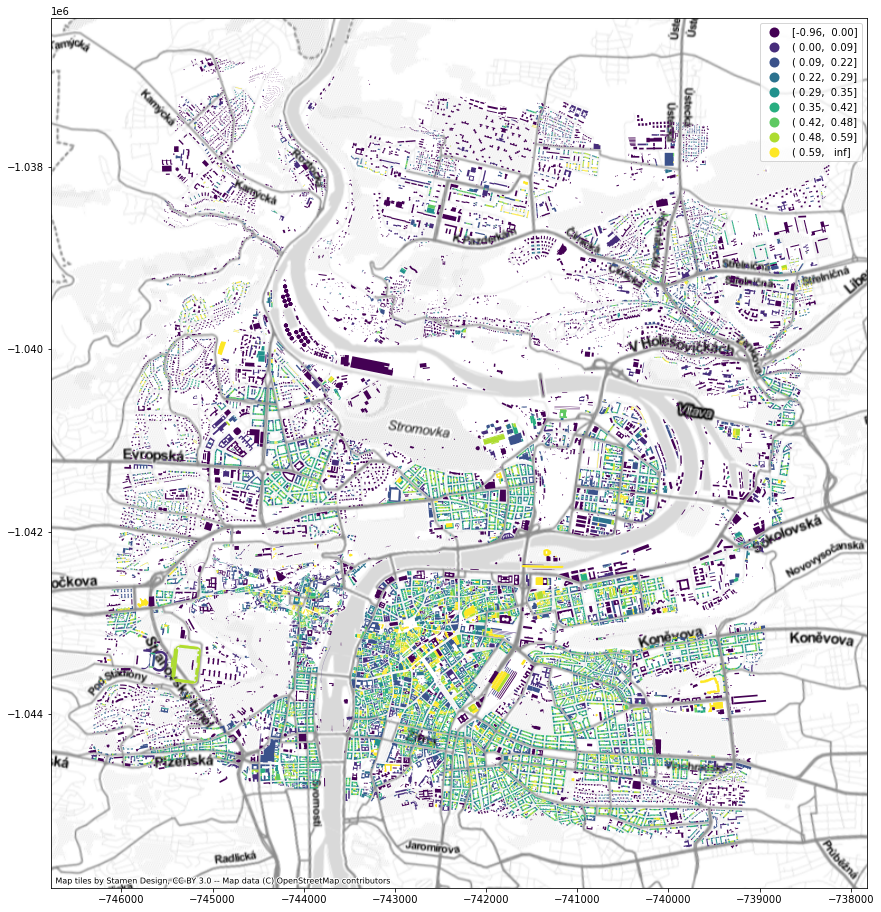

In [130]:
sample_buildings['shared_walls_ratio'] = momepy.SharedWallsRatio(sample_buildings.buffer(0)).series
ax = sample_buildings.plot('shared_walls_ratio', figsize=(16, 16), legend=True, scheme='quantiles', k=10)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

In [91]:
import libpysal

In [92]:
w = libpysal.weights.Queen.from_dataframe(bubenec_tess)

(<Figure size 1152x1152 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fdf610c9310>)

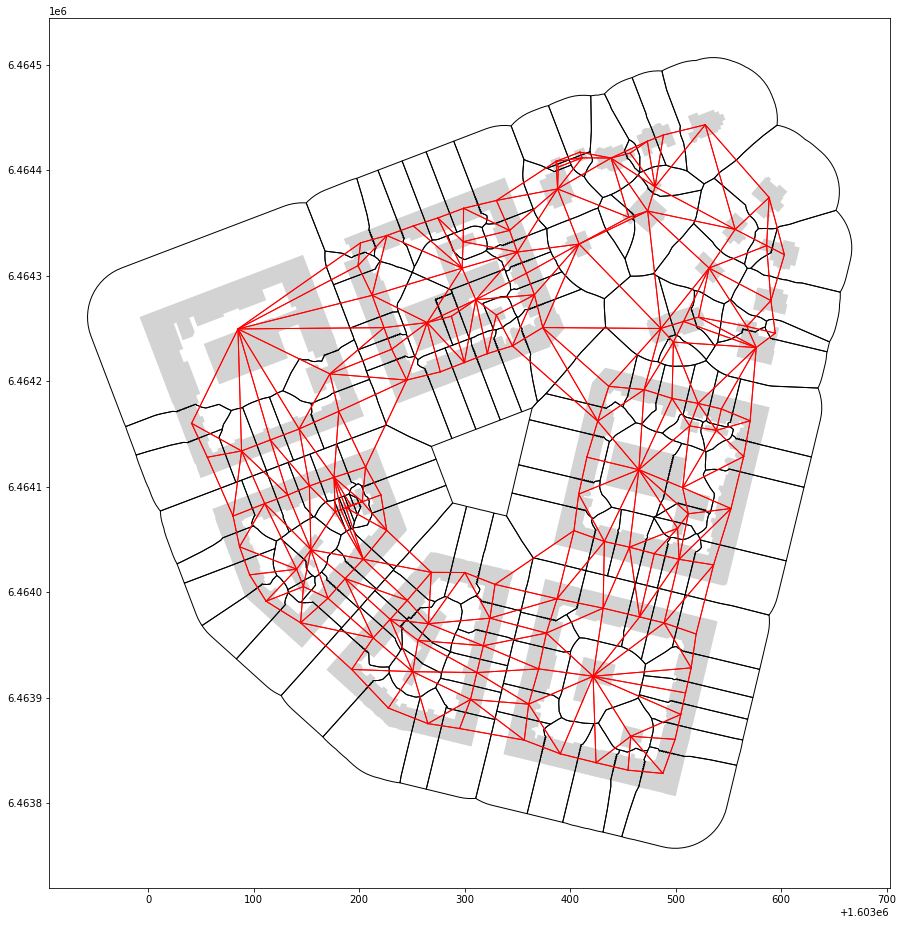

In [127]:
ax = bubenec_blg.plot(figsize=(16, 16), color='lightgrey')
bubenec_tess.plot(ax=ax, facecolor='none', edgecolor='k')
w.plot(bubenec_blg, ax=ax, 
        edge_kws=dict(color='r', linewidth=1),
        node_kws=dict(marker=''))

In [100]:
sample_weights = libpysal.weights.Queen.from_dataframe(sample_tessellation, ids='uID')

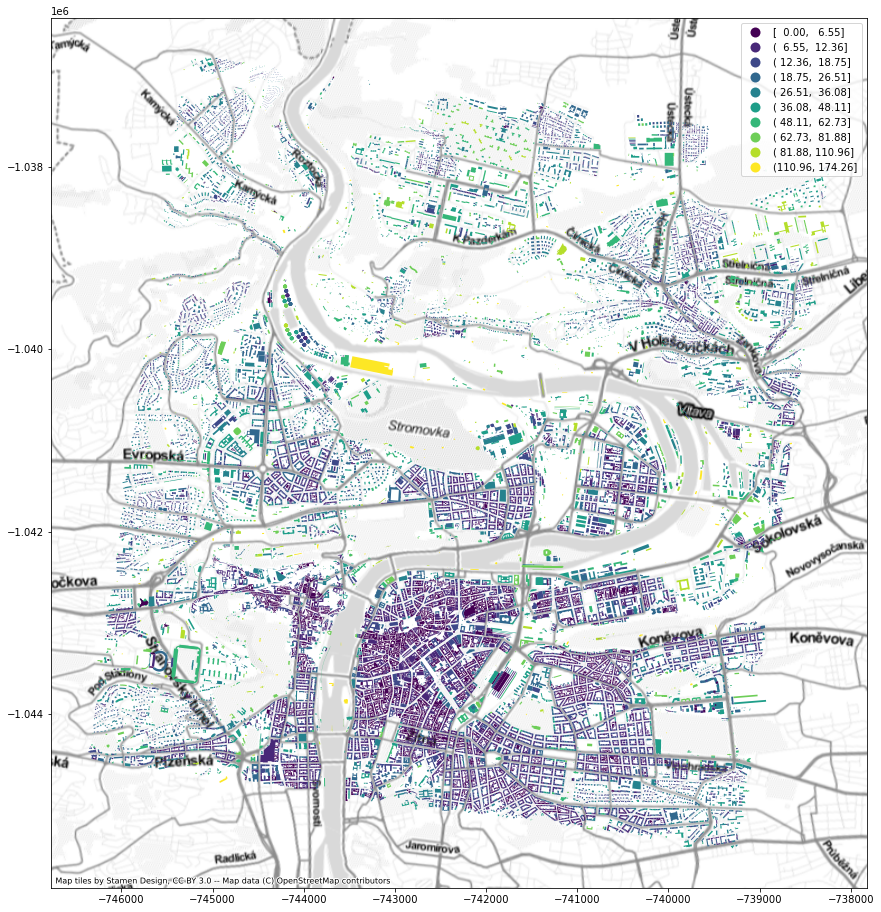

In [126]:
sample_buildings['neighbour_dist'] = momepy.NeighborDistance(sample_buildings, sample_weights, 'uID').series
ax = sample_buildings.plot('neighbour_dist', figsize=(16, 16), legend=True, scheme='naturalbreaks', k=10)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

In [102]:
sw3 = momepy.sw_high(k=3, weights=sample_weights)

In [105]:
avg_area = momepy.AverageCharacter(
    sample_tessellation, sample_tessellation.area, spatial_weights=sw3, unique_id='uID')
sample_tessellation['mean_area'] = avg_area.mean
sample_tessellation['median_area'] = avg_area.median

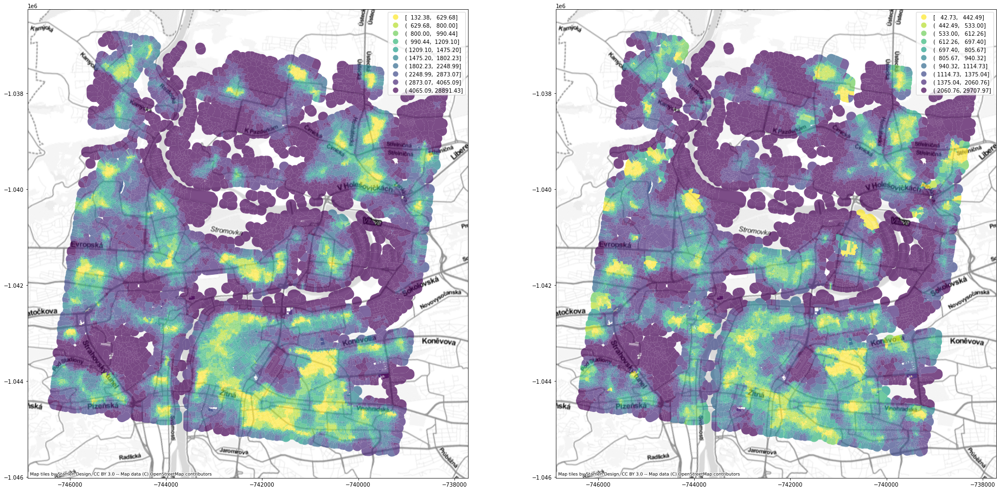

In [131]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_tessellation.plot('mean_area', ax=axs[0], scheme='quantiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
sample_tessellation.plot('median_area', ax=axs[1], scheme='quantiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

## Network analysis

In [160]:
G

In [163]:
place = 'Prague, Czechia'
gdf = ox.geocode_to_gdf(place)
area = ox.project_gdf(gdf).unary_union.area

stats = ox.basic_stats(G, area=area)

In [164]:
stats

{'n': 20880,
 'm': 48501,
 'k_avg': 4.645689655172414,
 'intersection_count': 17224,
 'streets_per_node_avg': 2.8129310344827587,
 'streets_per_node_counts': {0: 0,
  1: 3656,
  2: 460,
  3: 13059,
  4: 3561,
  5: 128,
  6: 15,
  7: 1},
 'streets_per_node_proportion': {0: 0.0,
  1: 0.17509578544061302,
  2: 0.022030651340996167,
  3: 0.6254310344827586,
  4: 0.17054597701149427,
  5: 0.006130268199233717,
  6: 0.0007183908045977011,
  7: 4.789272030651341e-05},
 'edge_length_total': 5787933.19500003,
 'edge_length_avg': 119.3363682192126,
 'street_length_total': 3577756.548000018,
 'street_length_avg': 121.81255483299915,
 'street_segments_count': 29371,
 'node_density_km': 42.10617818925418,
 'intersection_density_km': 34.73356384730431,
 'edge_density_km': 11671.82693755606,
 'street_density_km': 7214.830207272974,
 'circuity_avg': 1.066699619378294,
 'self_loop_proportion': 0.003381373579926187,
 'clean_intersection_count': None,
 'clean_intersection_density_km': None}

In [166]:
graph = momepy.gdf_to_nx(sample_streets)

In [169]:
graph = momepy.meshedness(graph, radius=5, name='meshedness')
graph = momepy.meshedness(graph, radius=800, name='meshedness800', distance='mm_len')

100%|██████████| 8136/8136 [00:43<00:00, 186.15it/s]


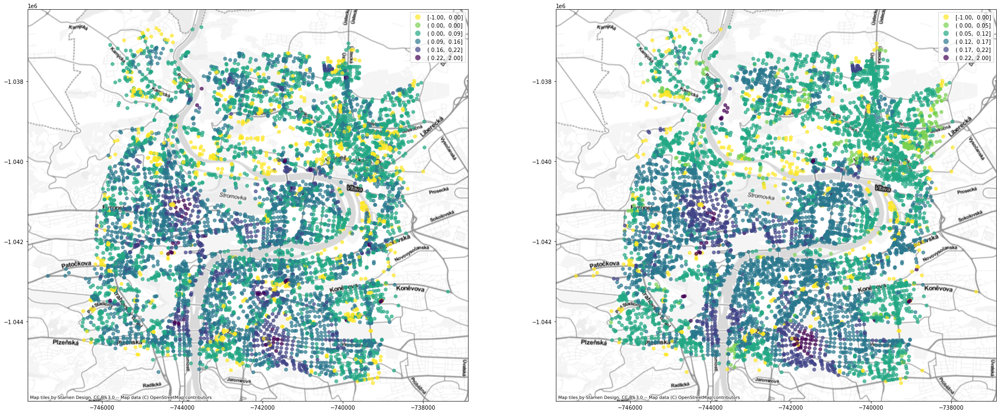

In [176]:
nodes = momepy.nx_to_gdf(graph, points=True, lines=False, spatial_weights=False)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('meshedness', ax=axs[0], scheme='percentiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
nodes.plot('meshedness800', ax=axs[1], scheme='percentiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

In [178]:
graph = momepy.closeness_centrality(graph, radius=400, name='closeness400', distance='mm_len', weight='mm_len')
graph = momepy.closeness_centrality(graph, name='closeness_global', weight='mm_len')

100%|██████████| 8136/8136 [00:13<00:00, 594.18it/s]


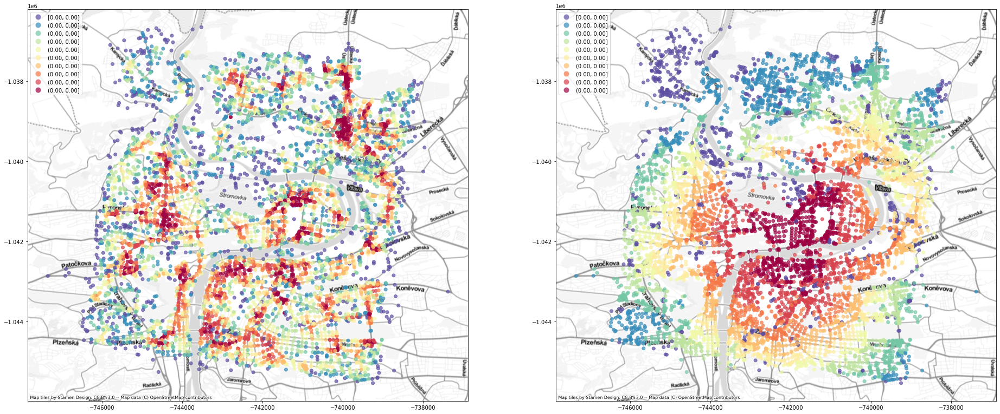

In [180]:
nodes = momepy.nx_to_gdf(graph, lines=False)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('closeness400', ax=axs[0], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
nodes.plot('closeness_global', ax=axs[1], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

In [181]:
graph = momepy.betweenness_centrality(graph, name='betweenness_metric_n', mode='nodes', weight='mm_len')
graph = momepy.betweenness_centrality(graph, name='betweenness_metric_e', mode='edges', weight='mm_len')

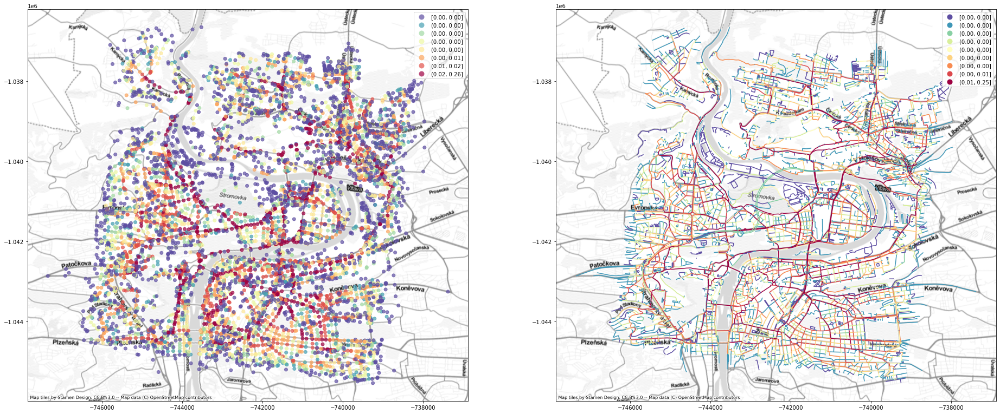

In [183]:
nodes, edges = momepy.nx_to_gdf(graph)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('betweenness_metric_n', ax=axs[0], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
edges.plot('betweenness_metric_e', ax=axs[1], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=1)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

## What can I do with it?